In [22]:
#%matplotlib inline
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.nn.functional as F
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import torchvision.models as models
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
import json
from PIL import Image


# Set random seed for reproducibility
manualSeed = 999
#manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)
torch.use_deterministic_algorithms(True) # Needed for reproducible results

Random Seed:  999


In [23]:
dataroot = "data/iclevr"
annotation_file = "data/train.json"
objects_file = "data/objects.json"
workers = 2
batch_size = 128
image_size = 64
# Number of channels in the training images. For color images this is 3
nc = 3
# Size of z latent vector (i.e. size of generator input)
nz = 100
# Size of feature maps in generator
ngf = 64
# Size of feature maps in discriminator
ndf = 64
num_epochs = 10
lr = 0.0002
# Beta1 hyperparameter for Adam optimizers
beta1 = 0.5
# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

with open(objects_file, "r") as f:
    label_map = json.load(f)

label_n_classes = len(label_map)
latent_class_dim = 10

In [24]:
def labels_to_multilabels(labels, label_map):
    # 創建一個全 0 的 tensor，大小為 label_map 的長度
    multi_label_tensor = torch.zeros(len(label_map))
    
    # 遍歷傳入的標籤列表
    for label in labels:
        # 根據 label_map 獲取對應的索引，並將該位置設為 1
        label_index = label_map[label]
        multi_label_tensor[label_index] = 1
    
    return multi_label_tensor

def multilabels_to_labels(multi_label_tensor, label_map):
    # 創建一個空列表來存儲標籤
    labels = []
    
    # 獲取 label_map 的反向映射，將索引映射回標籤
    index_to_label = {v: k for k, v in label_map.items()}
    
    # 遍歷 multi_label_tensor
    for index, value in enumerate(multi_label_tensor):
        # 如果該位置的值為 1，則將對應的標籤添加到列表中
        if value == 1:
            labels.append(index_to_label[index])
    
    return labels

cuda:0


2
torch.Size([128, 3, 64, 64])
torch.Size([128, 24])
['red cube', 'blue cube', 'gray cylinder']


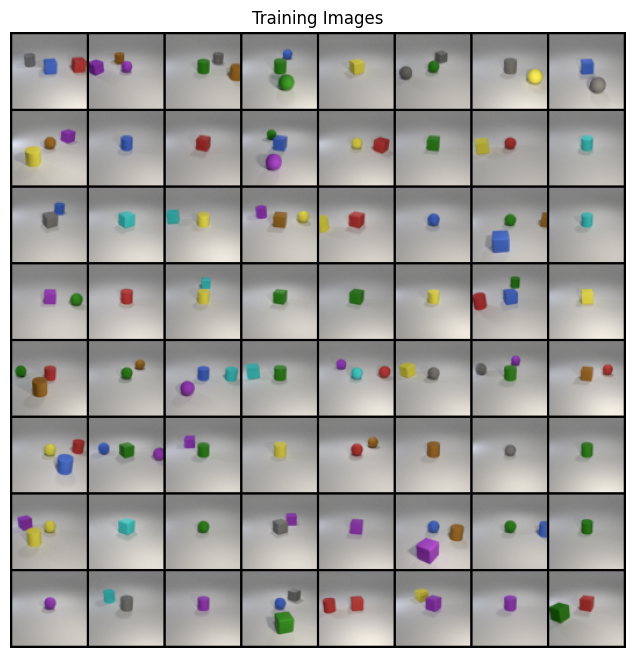

In [25]:
class IclevrDataset(torch.utils.data.Dataset):
    def __init__(self, root, annotation_file, objects_file, transform=None):
        self.root = root
        self.transform = transform
        with open(objects_file, "r") as f:
            label_map = json.load(f)
        self.annotation_map = {
            key: labels_to_multilabels(value, label_map)
            for key, value in self.load_annotation_map_file(annotation_file).items()}
        self.images = [key for key in self.annotation_map.keys()]
        self.images.sort()

    def load_annotation_map_file(self, annotation_file):
        with open(annotation_file, 'r') as f:
            annotation_map = json.load(f)
        return annotation_map

    def __len__(self):
        return len(self.images)

    def __getitem__(self, idx):
        image_path = os.path.join(self.root, self.images[idx])
        image = Image.open(image_path).convert('RGB')
        image = self.transform(image)
        labels = self.annotation_map[self.images[idx]]
        return (image, labels)

dataset = IclevrDataset(root=dataroot,
                        annotation_file=annotation_file,
                        objects_file=objects_file,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))
# Create the dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")
print(device)


# Plot some training images
real_batch = next(iter(dataloader))
print(len(real_batch))
print(real_batch[0].shape)
print(real_batch[1].shape)
print(multilabels_to_labels(real_batch[1][0], label_map))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))
plt.show()

In [26]:
# custom weights initialization called on ``netG`` and ``netD``
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [27]:
# Generator Code

class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.ex = nn.Linear(label_n_classes, latent_class_dim)
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d( nz + latent_class_dim, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. ``(ngf*8) x 4 x 4``
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. ``(ngf*4) x 8 x 8``
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. ``(ngf*2) x 16 x 16``
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. ``(ngf) x 32 x 32``
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. ``(nc) x 64 x 64``
        )

    def forward(self, input, labels):
        labels = self.ex(labels)
        labels = labels.view(labels.size(0), labels.size(1), 1, 1)
        input = torch.cat((input, labels), 1)
        return self.main(input)

# Create the generator
netG = Generator(ngpu).to(device)

# Handle multi-GPU if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the ``weights_init`` function to randomly initialize all weights
#  to ``mean=0``, ``stdev=0.02``.
netG.apply(weights_init)

# Print the model
print(netG)

Generator(
  (ex): Linear(in_features=24, out_features=10, bias=True)
  (main): Sequential(
    (0): ConvTranspose2d(110, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=

In [28]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.ex = nn.Linear(label_n_classes, ndf * ndf)
        self.main = nn.Sequential(
            # input is ``(nc) x 64 x 64``
            nn.Conv2d(nc + 1, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf) x 32 x 32``
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*2) x 16 x 16``
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*4) x 8 x 8``
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*8) x 4 x 4``
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input, labels):
        labels = self.ex(labels)
        labels = labels.view(-1, 1, ndf, ndf)
        input = torch.cat((input, labels), 1)
        return self.main(input)

# Create the Discriminator
netD = Discriminator(ngpu).to(device)

# Handle multi-GPU if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Apply the ``weights_init`` function to randomly initialize all weights
# like this: ``to mean=0, stdev=0.2``.
netD.apply(weights_init)

# Print the model
print(netD)

Discriminator(
  (ex): Linear(in_features=24, out_features=4096, bias=True)
  (main): Sequential(
    (0): Conv2d(4, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=Fa

In [29]:
class evaluation_model():
    def __init__(self):
        #modify the path to your own path
        checkpoint = torch.load('./data/checkpoint.pth')
        self.resnet18 = models.resnet18(pretrained=False)
        self.resnet18.fc = nn.Sequential(
            nn.Linear(512,24),
            nn.Sigmoid()
        )
        self.resnet18.load_state_dict(checkpoint['model'])
        self.resnet18 = self.resnet18.cuda()
        self.resnet18.eval()
        self.classnum = 24
    def compute_acc(self, out, onehot_labels):
        batch_size = out.size(0)
        acc = 0
        total = 0
        for i in range(batch_size):
            k = int(onehot_labels[i].sum().item())
            total += k
            outv, outi = out[i].topk(k)
            lv, li = onehot_labels[i].topk(k)
            for j in outi:
                if j in li:
                    acc += 1
        return acc / total
    def eval(self, images, labels):
        with torch.no_grad():
            #your image shape should be (batch, 3, 64, 64)
            out = self.resnet18(images)
            acc = self.compute_acc(out.cpu(), labels.cpu())
            return acc

eval_model = evaluation_model()

/home/jteng2127/miniconda3/lib/python3.12/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/home/jteng2127/miniconda3/lib/python3.12/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)


In [30]:
# Initialize the ``BCELoss`` function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)
real_batch_labels = real_batch[1][:64].to(device)

# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

In [31]:
# Training Loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device)
        real_labels = data[1].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # Forward pass real batch through D
        output = netD(real_cpu, real_labels).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise, real_labels)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach(), real_labels).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch, accumulated (summed) with previous gradients
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Compute error of D as sum over the fake and the real batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake, real_labels).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()

        # Output training stats
        if i % 50 == 0:
            print(eval_model.eval(fake, real_labels))
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 50 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise, real_batch_labels).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

Starting Training Loop...


/home/jteng2127/miniconda3/lib/python3.12/site-packages/torch/nn/modules/conv.py:456: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at ../aten/src/ATen/native/cudnn/Conv_v8.cpp:919.)
  return F.conv2d(input, weight, bias, self.stride,


0.08045977011494253
[0/10][0/141]	Loss_D: 2.0317	Loss_G: 3.0848	D(x): 0.4370	D(G(z)): 0.5754 / 0.0686
0.07851239669421488
[0/10][50/141]	Loss_D: 1.9270	Loss_G: 15.1166	D(x): 0.9977	D(G(z)): 0.7466 / 0.0000
0.104
[0/10][100/141]	Loss_D: 0.3070	Loss_G: 6.2485	D(x): 0.8637	D(G(z)): 0.0128 / 0.0029
0.08064516129032258
[1/10][0/141]	Loss_D: 0.4110	Loss_G: 7.2830	D(x): 0.9333	D(G(z)): 0.2598 / 0.0012
0.08695652173913043
[1/10][50/141]	Loss_D: 0.1645	Loss_G: 4.2393	D(x): 0.8989	D(G(z)): 0.0440 / 0.0234
0.07086614173228346
[1/10][100/141]	Loss_D: 0.3646	Loss_G: 8.0293	D(x): 0.9343	D(G(z)): 0.2212 / 0.0012
0.07749077490774908
[2/10][0/141]	Loss_D: 0.1377	Loss_G: 5.0892	D(x): 0.9804	D(G(z)): 0.1003 / 0.0170
0.07450980392156863
[2/10][50/141]	Loss_D: 0.0943	Loss_G: 5.4406	D(x): 0.9703	D(G(z)): 0.0593 / 0.0060
0.11969111969111969
[2/10][100/141]	Loss_D: 2.9116	Loss_G: 8.7510	D(x): 0.1927	D(G(z)): 0.0000 / 0.0024
0.1078838174273859
[3/10][0/141]	Loss_D: 0.1071	Loss_G: 4.4561	D(x): 0.9701	D(G(z)): 0

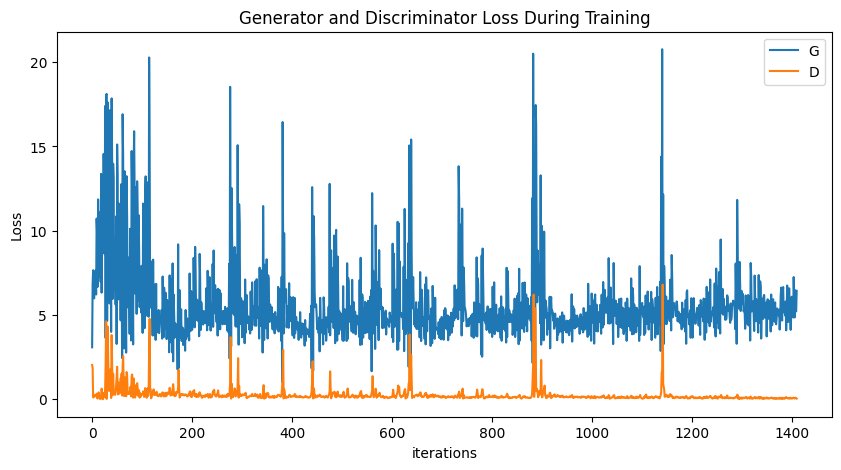

In [32]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

['red cube', 'blue cube', 'gray cylinder']
['purple cube', 'purple sphere', 'brown cylinder']
['gray cylinder', 'green cylinder', 'brown cylinder']
['blue sphere', 'green sphere', 'green cylinder']
['yellow cube']
['gray cube', 'gray sphere', 'green sphere']
['yellow sphere', 'gray cylinder']
['blue cube', 'gray sphere']
['purple cube', 'brown sphere', 'yellow cylinder']
['blue cylinder']
['red cube']
['blue cube', 'green sphere', 'purple sphere']
['red cube', 'yellow sphere']
['green cube']
['yellow cube', 'red sphere']
['cyan cylinder']
['gray cube', 'blue cylinder']
['cyan cube']
['cyan cube', 'yellow cylinder']
['brown cube', 'yellow sphere', 'purple cylinder']
['red cube', 'yellow cylinder']
['blue sphere']
['blue cube', 'brown cube', 'green sphere']
['cyan cylinder']
['purple cube', 'green sphere']
['red cylinder']
['cyan cube', 'yellow cylinder']
['green cube']
['green cube']
['yellow cylinder']
['blue cube', 'red cylinder', 'green cylinder']
['yellow cube']
['green sphere', 're

Animation size has reached 21474924 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


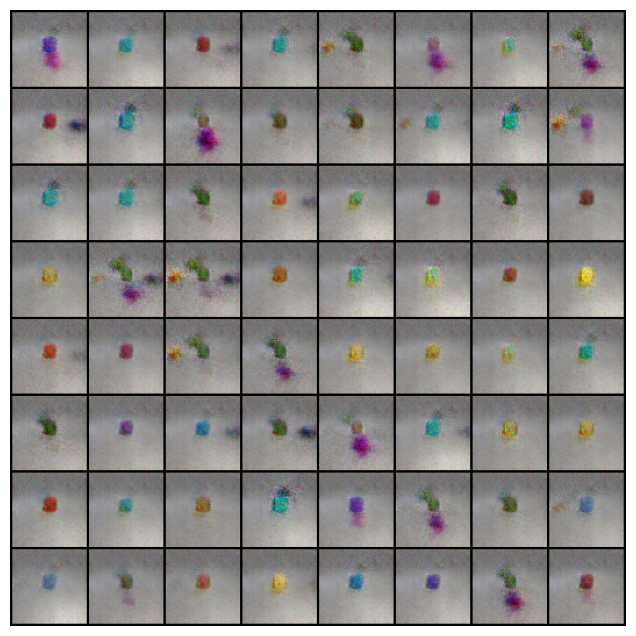

In [33]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

for labels in real_batch_labels:
    print(multilabels_to_labels(labels, label_map))

HTML(ani.to_jshtml())

['red cube', 'blue cube', 'gray cylinder']
['purple cube', 'purple sphere', 'brown cylinder']
['gray cylinder', 'green cylinder', 'brown cylinder']
['blue sphere', 'green sphere', 'green cylinder']
['yellow cube']
['gray cube', 'gray sphere', 'green sphere']
['yellow sphere', 'gray cylinder']
['blue cube', 'gray sphere']
['purple cube', 'brown sphere', 'yellow cylinder']
['blue cylinder']
['red cube']
['blue cube', 'green sphere', 'purple sphere']
['red cube', 'yellow sphere']
['green cube']
['yellow cube', 'red sphere']
['cyan cylinder']
['gray cube', 'blue cylinder']
['cyan cube']
['cyan cube', 'yellow cylinder']
['brown cube', 'yellow sphere', 'purple cylinder']
['red cube', 'yellow cylinder']
['blue sphere']
['blue cube', 'brown cube', 'green sphere']
['cyan cylinder']
['purple cube', 'green sphere']
['red cylinder']
['cyan cube', 'yellow cylinder']
['green cube']
['green cube']
['yellow cylinder']
['blue cube', 'red cylinder', 'green cylinder']
['yellow cube']
['green sphere', 're

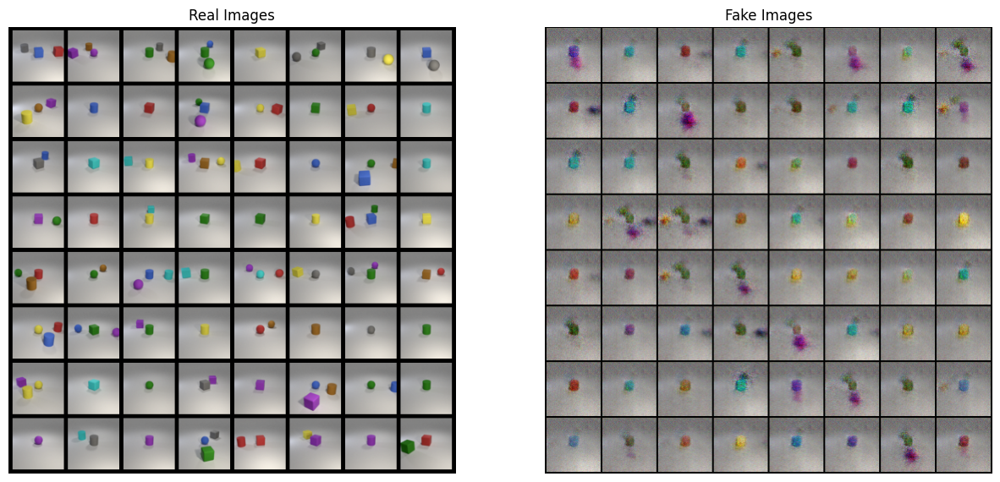

In [34]:
# Grab a batch of real images from the dataloader
for labels in real_batch[1]:
    print(multilabels_to_labels(labels, label_map))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()